In [1]:
import cv2
import numpy as np
import gym
from collections import deque
from tensorflow.keras.models import Sequential, clone_model
from tensorflow.keras.layers import Dense, Flatten, Conv2D, Input
from tensorflow.keras.optimizers import Adam
import keras.backend as K
import tensorflow as tf
import random
import matplotlib.pyplot as plt
import time

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

import matplotlib.animation as animation
mpl.rc('animation', html='jshtml')

C:\Users\Peridot\.conda\envs\tf_cpu\lib\site-packages\gym\envs\registration.py:424: UserWarning: WARN: Custom namespace `ALE` is being overridden by namespace `ALE`. If you are developing a plugin you shouldn't specify a namespace in `register` calls. The namespace is specified through the entry point package metadata.
  f"Custom namespace `{spec.namespace}` is being overridden "


In [2]:
def resize_frame(frame):
    frame = frame[30:-12,5:-4]
    frame = np.average(frame,axis = 2)
    frame = cv2.resize(frame,(84,84),interpolation = cv2.INTER_NEAREST)
    frame = np.array(frame,dtype = np.uint8)
    return frame

Recall that our frames are a matrix of pixel values. To add the directional information into our input, we can simply stack our frames together to form a tensor. Taking our frame's shape to be (84,84), the shape of our state will be (84,84, 4) if we stack the most recent 4 frames together. So at time t in-game, our current state is a stack of the frames at t, t-1, t-2, and t-3.

In [3]:
class Memory():
    def __init__(self,max_len):
        self.max_len = max_len
        self.frames = deque(maxlen = max_len)
        self.actions = deque(maxlen = max_len)
        self.rewards = deque(maxlen = max_len)
        self.done_flags = deque(maxlen = max_len)

    def add_experience(self,next_frame, next_frames_reward, next_action, next_frame_terminal):
        self.frames.append(next_frame)
        self.actions.append(next_action)
        self.rewards.append(next_frames_reward)
        self.done_flags.append(next_frame_terminal)

In [4]:
def initialize_new_game(name, env, agent):
    """We don't want an agents past game influencing its new game, so we add in some dummy data to initialize"""
    
    env.reset()
    starting_frame = resize_frame(env.step(0)[0])

    dummy_action = 0
    dummy_reward = 0
    dummy_done = False
    for i in range(3):
        agent.memory.add_experience(starting_frame, dummy_reward, dummy_action, dummy_done)

def make_env(name, agent):
    env = gym.make(name)
    return env

def take_step(name, env, agent, score, debug):
    
    #1 and 2: Update timesteps and save weights
    agent.total_timesteps += 1
    if agent.total_timesteps % 50000 == 0:
      agent.model.save_weights('recent_weights.hdf5')
      print('\nWeights saved!')

    #3: Take action
    next_frame, next_frames_reward, next_frame_terminal, info = env.step(agent.memory.actions[-1])
    
    #4: Get next state
    next_frame = resize_frame(next_frame)
    new_state = [agent.memory.frames[-3], agent.memory.frames[-2], agent.memory.frames[-1], next_frame]
    new_state = np.moveaxis(new_state,0,2)/255 #We have to do this to get it into keras's goofy format of [batch_size,rows,columns,channels]
    new_state = np.expand_dims(new_state,0) #^^^
    
    #5: Get next action, using next state
    next_action = agent.get_action(new_state)

    #6: Now we add the next experience to memory
    agent.memory.add_experience(next_frame, next_frames_reward, next_action, next_frame_terminal)
    
    #7: If game is over, return the score
    if next_frame_terminal:
        return (score + next_frames_reward),True

    #8: If we are trying to debug this then render
    if debug:
        img = env.render(mode="rgb_array")
        global frames
        frames.append(img)

    #9: If the threshold memory is satisfied, make the agent learn from memory
    if len(agent.memory.frames) > agent.starting_mem_len:
        agent.learn(debug)

    return (score + next_frames_reward),False

def play_episode(name, env, agent, debug = False):
    initialize_new_game(name, env, agent)
    done = False
    score = 0
    while True:
        score,done = take_step(name,env,agent,score, debug)
        if done:
            break
    return score

In [5]:
class Agent():
    def __init__(self,possible_actions,starting_mem_len,max_mem_len,starting_epsilon,learn_rate, starting_lives = 5, debug = False):
        self.memory = Memory(max_mem_len)
        self.possible_actions = possible_actions
        self.epsilon = starting_epsilon
        self.epsilon_decay = .9/100000
        self.epsilon_min = .05
        self.gamma = .95
        self.learn_rate = learn_rate
        self.model = self._build_model()
        self.model_target = clone_model(self.model)
        self.total_timesteps = 0
        self.lives = starting_lives #this parameter does not apply to pong
        self.starting_mem_len = starting_mem_len
        self.learns = 0


    def _build_model(self):
        model = Sequential()
        model.add(Input((84,84,4)))
        model.add(Conv2D(filters = 32,kernel_size = (8,8),strides = 4,data_format="channels_last", activation = 'relu',kernel_initializer = tf.keras.initializers.VarianceScaling(scale=2)))
        model.add(Conv2D(filters = 64,kernel_size = (4,4),strides = 2,data_format="channels_last", activation = 'relu',kernel_initializer = tf.keras.initializers.VarianceScaling(scale=2)))
        model.add(Conv2D(filters = 64,kernel_size = (3,3),strides = 1,data_format="channels_last", activation = 'relu',kernel_initializer = tf.keras.initializers.VarianceScaling(scale=2)))
        model.add(Flatten())
        model.add(Dense(512,activation = 'relu', kernel_initializer = tf.keras.initializers.VarianceScaling(scale=2)))
        model.add(Dense(len(self.possible_actions), activation = 'linear'))
        optimizer = Adam(self.learn_rate)
        model.compile(optimizer, loss=tf.keras.losses.Huber())
        model.summary()
        print('\nAgent Initialized\n')
        return model

    def get_action(self,state):
        """Explore"""
        if np.random.rand() < self.epsilon:
            return random.sample(self.possible_actions,1)[0]

        """Do Best Acton"""
        a_index = np.argmax(self.model.predict(state))
        return self.possible_actions[a_index]

    def _index_valid(self,index):
        if self.memory.done_flags[index-3] or self.memory.done_flags[index-2] or self.memory.done_flags[index-1] or self.memory.done_flags[index]:
            return False
        else:
            return True

    def learn(self,debug = False):
        """we want the output[a] to be R_(t+1) + Qmax_(t+1)."""
        """So target for taking action 1 should be [output[0], R_(t+1) + Qmax_(t+1), output[2]]"""

        """First we need 32 random valid indicies"""
        states = []
        next_states = []
        actions_taken = []
        next_rewards = []
        next_done_flags = []

        while len(states) < 32:
            index = np.random.randint(4,len(self.memory.frames) - 1)
            if self._index_valid(index):
                state = [self.memory.frames[index-3], self.memory.frames[index-2], self.memory.frames[index-1], self.memory.frames[index]]
                state = np.moveaxis(state,0,2)/255
                next_state = [self.memory.frames[index-2], self.memory.frames[index-1], self.memory.frames[index], self.memory.frames[index+1]]
                next_state = np.moveaxis(next_state,0,2)/255

                states.append(state)
                next_states.append(next_state)
                actions_taken.append(self.memory.actions[index])
                next_rewards.append(self.memory.rewards[index+1])
                next_done_flags.append(self.memory.done_flags[index+1])

        """Now we get the ouputs from our model, and the target model. We need this for our target in the error function"""
        labels = self.model.predict(np.array(states))
        next_state_values = self.model_target.predict(np.array(next_states))
        
        """Now we define our labels, or what the output should have been
           We want the output[action_taken] to be R_(t+1) + Qmax_(t+1) """
        for i in range(32):
            action = self.possible_actions.index(actions_taken[i])
            labels[i][action] = next_rewards[i] + (not next_done_flags[i]) * self.gamma * max(next_state_values[i])

        """Train our model using the states and outputs generated"""
        self.model.fit(np.array(states),labels,batch_size = 32, epochs = 1, verbose = 0)

        """Decrease epsilon and update how many times our agent has learned"""
        if self.epsilon > self.epsilon_min:
            self.epsilon -= self.epsilon_decay
        self.learns += 1
        
        """Every 10000 learned, copy our model weights to our target model"""
        if self.learns % 10000 == 0:
            self.model_target.set_weights(self.model.get_weights())
            print('\nTarget model updated')

In [6]:
def plot_animation(frames, repeat=False, interval=40):
    fig = plt.figure()
    patch = plt.imshow(frames[0])
    plt.axis('off')
    anim = animation.FuncAnimation(
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat=repeat, interval=interval)
    plt.close()
    return anim

In [7]:
name = 'PongDeterministic-v4'

agent = Agent(possible_actions=[0,2,3],starting_mem_len=50000,max_mem_len=750000,starting_epsilon = 1, learn_rate = .0005)
env = make_env(name,agent)

last_100_avg = [-21]
scores = deque(maxlen = 100)
max_score = -21
 
env.reset()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 20, 20, 32)        8224      
                                                                 
 conv2d_1 (Conv2D)           (None, 9, 9, 64)          32832     
                                                                 
 conv2d_2 (Conv2D)           (None, 7, 7, 64)          36928     
                                                                 
 flatten (Flatten)           (None, 3136)              0         
                                                                 
 dense (Dense)               (None, 512)               1606144   
                                                                 
 dense_1 (Dense)             (None, 3)                 1539      
                                                                 
Total params: 1,685,667
Trainable params: 1,685,667
Non-

array([[[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [109, 118,  43],
        [109, 118,  43],
        [109, 118,  43]],

       [[109, 118,  43],
        [109, 118,  43],
        [109, 118,  43],
        ...,
        [109, 118,  43],
        [109, 118,  43],
        [109, 118,  43]],

       [[109, 118,  43],
        [109, 118,  43],
        [109, 118,  43],
        ...,
        [109, 118,  43],
        [109, 118,  43],
        [109, 118,  43]],

       ...,

       [[ 53,  95,  24],
        [ 53,  95,  24],
        [ 53,  95,  24],
        ...,
        [ 53,  95,  24],
        [ 53,  95,  24],
        [ 53,  95,  24]],

       [[ 53,  95,  24],
        [ 53,  95,  24],
        [ 53,  95,  24],
        ...,
        [ 53,  95,  24],
        [ 53,  95,  24],
        [ 53,  95,  24]],

       [[ 53,  95,  24],
        [ 53,  95,  24],
        [ 53,  95,  24],
        ...,
        [ 53,  95,  24],
        [ 53,  95,  24],
        [ 53,  95,  24]]

In [ ]:
agent.model.load_weights('recent_weights.hdf5')
agent.model_target.load_weights('recent_weights.hdf5')
agent.epsilon = 0 # Set the epsilon at the value you had when you stopped training

1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 38ms/step

Episode: 0
Steps: 764
Duration: 30.955243825912476
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 30ms/step

Episode: 1
Steps: 764
Duration: 31.343879461288452
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 2
Steps: 764
Duration: 73.36059308052063
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 3
Steps: 764
Duration: 12.00184154510498
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 4
Steps: 764
Duration: 13.679772853851318
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 5
Steps: 764
Duration: 13.854936838150024
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 6
Steps: 764
Duration: 12.876954555511475
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 7
Steps: 764
Duration: 12.442831993103027
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 8
Steps: 764
Duration: 12.260891914367676
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 14ms/step

Episode: 9
Steps: 764
Duration: 13.579078197479248
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 10
Steps: 824
Duration: 13.932023525238037
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 11
Steps: 764
Duration: 12.720622777938843
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 12
Steps: 764
Duration: 11.738401174545288
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 13
Steps: 764
Duration: 12.656275510787964
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 14
Steps: 764
Duration: 12.421237468719482
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 15
Steps: 764
Duration: 12.699001550674438
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 16
Steps: 764
Duration: 12.548660516738892
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 17
Steps: 764
Duration: 13.690601825714111
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 18
Steps: 764
Duration: 13.079429388046265
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 19
Steps: 764
Duration: 13.141912937164307
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 20
Steps: 764
Duration: 12.844250679016113
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 21
Steps: 764
Duration: 13.588132381439209
Score: -21.0
Max Score: -18.0
Epsilon: 0.6
1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 17ms/step

Episode: 22
Steps: 1547
Duration: 26.058244228363037
Score: -16.0
Max Score: -16.0
Epsilon: 0.6
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 23
Steps: 764
Duration: 13.07190752029419
Score: -21.0
Max Score: -16.0
Epsilon: 0.6
1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 24
Steps: 764
Duration: 12.497916460037231
Score: -21.0
Max Score: -16.0
Epsilon: 0.6
1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 17ms/step

Episode: 25
Steps: 764
Duration: 12.44417953491211
Score: -21.0
Max Score: -16.0
Epsilon: 0.6
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 26
Steps: 764
Duration: 13.215066194534302
Score: -21.0
Max Score: -16.0
Epsilon: 0.6
1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 27
Steps: 764
Duration: 13.13575530052185
Score: -21.0
Max Score: -16.0
Epsilon: 0.6
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 28
Steps: 764
Duration: 12.510201215744019
Score: -21.0
Max Score: -16.0
Epsilon: 0.6
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 29
Steps: 764
Duration: 13.021813154220581
Score: -21.0
Max Score: -16.0
Epsilon: 0.6
1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 30
Steps: 764
Duration: 13.789594173431396
Score: -21.0
Max Score: -16.0
Epsilon: 0.6
1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 31
Steps: 764
Duration: 14.249621152877808
Score: -21.0
Max Score: -16.0
Epsilon: 0.6
1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 32
Steps: 764
Duration: 13.626041889190674
Score: -21.0
Max Score: -16.0
Epsilon: 0.6
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 33
Steps: 764
Duration: 13.03618860244751
Score: -21.0
Max Score: -16.0
Epsilon: 0.6
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 34
Steps: 764
Duration: 13.671205997467041
Score: -21.0
Max Score: -16.0
Epsilon: 0.6
1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 35
Steps: 764
Duration: 13.330284118652344
Score: -21.0
Max Score: -16.0
Epsilon: 0.6
1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 36
Steps: 764
Duration: 13.096897840499878
Score: -21.0
Max Score: -16.0
Epsilon: 0.6
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 37
Steps: 764
Duration: 13.778663158416748
Score: -21.0
Max Score: -16.0
Epsilon: 0.6
1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 38
Steps: 764
Duration: 11.362694501876831
Score: -21.0
Max Score: -16.0
Epsilon: 0.6
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 14ms/step

Episode: 39
Steps: 764
Duration: 12.9811851978302
Score: -21.0
Max Score: -16.0
Epsilon: 0.6
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 25ms/step

Weights saved!
1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 24ms/step

Episode: 40
Steps: 884
Duration: 132.21350169181824
Score: -21.0
Max Score: -16.0
Epsilon: 0.5939249999999752
1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step

Episode: 41
Steps: 824
Duration: 150.17398977279663
Score: -21.0
Max Score: -16.0
Epsilon: 0.5865179999999449
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step

Episode: 42
Steps: 979
Duration: 180.23556327819824
Score: -20.0
Max Score: -16.0
Epsilon: 0.577715999999909
1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 22ms/step

Episode: 43
Steps: 946
Duration: 183.25724267959595
Score: -21.0
Max Score: -16.0
Epsilon: 0.5692109999998742
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step

Episode: 44
Steps: 1384
Duration: 259.3145935535431
Score: -19.0
Max Score: -16.0
Epsilon: 0.5567639999998234
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step

Episode: 45
Steps: 886
Duration: 165.23348355293274
Score: -21.0
Max Score: -16.0
Epsilon: 0.5487989999997909
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 46
Steps: 1014
Duration: 191.53314566612244
Score: -19.0
Max Score: -16.0
Epsilon: 0.5396819999997536
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step

Episode: 47
Steps: 884
Duration: 166.74491548538208
Score: -21.0
Max Score: -16.0
Epsilon: 0.5317349999997212
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 21ms/step

Episode: 48
Steps: 1004
Duration: 190.2806088924408
Score: -21.0
Max Score: -16.0
Epsilon: 0.5227079999996843
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 49
Steps: 1067
Duration: 203.44365739822388
Score: -21.0
Max Score: -16.0
Epsilon: 0.5131139999996451


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 20ms/step

Target model updated
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 25ms/step

Episode: 50
Steps: 1260
Duration: 240.23764276504517
Score: -19.0
Max Score: -16.0
Epsilon: 0.5017829999995989
1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step

Episode: 51
Steps: 1067
Duration: 207.61150240898132
Score: -21.0
Max Score: -16.0
Epsilon: 0.49218899999960786
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 52
Steps: 1004
Duration: 195.76942539215088
Score: -21.0
Max Score: -16.0
Epsilon: 0.48316199999962667
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step

Episode: 53
Steps: 1068
Duration: 208.0823838710785
Score: -21.0
Max Score: -16.0
Epsilon: 0.4735589999996467
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 54
Steps: 1160
Duration: 226.86407494544983
Score: -20.0
Max Score: -16.0
Epsilon: 0.4631279999996684
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 19ms/step

Episode: 55
Steps: 1258
Duration: 246.33427667617798
Score: -19.0
Max Score: -16.0
Epsilon: 0.451814999999692
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step

Episode: 56
Steps: 1188
Duration: 233.93053936958313
Score: -21.0
Max Score: -16.0
Epsilon: 0.44113199999971425
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 57
Steps: 1102
Duration: 217.5251853466034
Score: -20.0
Max Score: -16.0
Epsilon: 0.4312229999997349
1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 22ms/step

Target model updated
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 58
Steps: 1319
Duration: 261.8043758869171
Score: -19.0
Max Score: -16.0
Epsilon: 0.4193609999997596
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 23ms/step

Episode: 59
Steps: 1283
Duration: 255.54544687271118
Score: -20.0
Max Score: -16.0
Epsilon: 0.40782299999978366
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 60
Steps: 1195
Duration: 238.3718798160553
Score: -19.0
Max Score: -16.0
Epsilon: 0.39707699999980606
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 61
Steps: 1125
Duration: 227.05448412895203
Score: -21.0
Max Score: -16.0
Epsilon: 0.38696099999982714
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 62
Steps: 1065
Duration: 216.0651957988739
Score: -21.0
Max Score: -16.0
Epsilon: 0.3773849999998471
1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 63
Steps: 1136
Duration: 230.06062507629395
Score: -19.0
Max Score: -16.0
Epsilon: 0.3671699999998684
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 64
Steps: 1382
Duration: 281.4884808063507
Score: -19.0
Max Score: -16.0
Epsilon: 0.3547409999998943
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 65
Steps: 1068
Duration: 218.70641422271729
Score: -21.0
Max Score: -16.0
Epsilon: 0.3451379999999143
1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 66
Steps: 1232
Duration: 253.9761893749237
Score: -18.0
Max Score: -16.0
Epsilon: 0.3340589999999374
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step

Target model updated
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 67
Steps: 1483
Duration: 307.0374276638031
Score: -16.0
Max Score: -16.0
Epsilon: 0.3207209999999652
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 68
Steps: 1623
Duration: 340.63537430763245
Score: -19.0
Max Score: -16.0
Epsilon: 0.3061229999999956
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 15ms/step

Episode: 69
Steps: 1041
Duration: 217.92973232269287
Score: -20.0
Max Score: -16.0
Epsilon: 0.2967630000000151
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 70
Steps: 1124
Duration: 235.9376654624939
Score: -21.0
Max Score: -16.0
Epsilon: 0.28665600000003616
1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 71
Steps: 1043
Duration: 219.2977225780487
Score: -20.0
Max Score: -16.0
Epsilon: 0.2772780000000557
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 72
Steps: 1382
Duration: 291.7824363708496
Score: -19.0
Max Score: -16.0
Epsilon: 0.2648490000000816
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 73
Steps: 1282
Duration: 272.6786136627197
Score: -20.0
Max Score: -16.0
Epsilon: 0.2533200000001056
1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 74
Steps: 1164
Duration: 246.89762496948242
Score: -20.0
Max Score: -16.0
Epsilon: 0.24285300000010537
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 23ms/step

Target model updated
1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 75
Steps: 1527
Duration: 327.1928949356079
Score: -20.0
Max Score: -16.0
Epsilon: 0.22911900000009164
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step

Episode: 76
Steps: 1370
Duration: 294.0039722919464
Score: -21.0
Max Score: -16.0
Epsilon: 0.21679800000007932
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 77
Steps: 1282
Duration: 277.4756999015808
Score: -20.0
Max Score: -16.0
Epsilon: 0.2052690000000678
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 78
Steps: 1864
Duration: 404.3506875038147
Score: -19.0
Max Score: -16.0
Epsilon: 0.18850200000005102
1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step

Episode: 79
Steps: 1447
Duration: 316.3351001739502
Score: -17.0
Max Score: -16.0
Epsilon: 0.175488000000038
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 80
Steps: 1317
Duration: 288.95788383483887
Score: -19.0
Max Score: -16.0
Epsilon: 0.16364400000002616
1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 28ms/step

Episode: 81
Steps: 1102
Duration: 241.85169339179993
Score: -20.0
Max Score: -16.0
Epsilon: 0.15373500000001625
1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step

Target model updated
1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step

Weights saved!
1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 17ms/step

Episode: 82
Steps: 1225
Duration: 271.47698950767517
Score: -20.0
Max Score: -16.0
Epsilon: 0.14271900000000523
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 83
Steps: 1680
Duration: 377.2007896900177
Score: -19.0
Max Score: -16.0
Epsilon: 0.12760799999999012
1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 84
Steps: 1597
Duration: 357.15800762176514
Score: -18.0
Max Score: -16.0
Epsilon: 0.11324399999999389
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 20ms/step

Episode: 85
Steps: 1907
Duration: 433.80499792099
Score: -21.0
Max Score: -16.0
Epsilon: 0.09609000000000319
1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 17ms/step

Episode: 86
Steps: 1645
Duration: 372.6555733680725
Score: -20.0
Max Score: -16.0
Epsilon: 0.0812940000000112
1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 18ms/step

Episode: 87
Steps: 1648
Duration: 375.5970892906189
Score: -20.0
Max Score: -16.0
Epsilon: 0.06647100000001924
1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 25ms/step

Target model updated
1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 88
Steps: 2048
Duration: 480.6027581691742
Score: -19.0
Max Score: -16.0
Epsilon: 0.04999200000001852
1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 89
Steps: 2121
Duration: 495.8716297149658
Score: -15.0
Max Score: -15.0
Epsilon: 0.04999200000001852
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 90
Steps: 1834
Duration: 427.204026222229
Score: -18.0
Max Score: -15.0
Epsilon: 0.04999200000001852


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 18ms/step

Episode: 91
Steps: 2203
Duration: 555.8205125331879
Score: -16.0
Max Score: -15.0
Epsilon: 0.04999200000001852
1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 17ms/step

Episode: 92
Steps: 2332
Duration: 584.2093155384064
Score: -16.0
Max Score: -15.0
Epsilon: 0.04999200000001852
1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step

Target model updated
1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 18ms/step

Episode: 93
Steps: 2017
Duration: 484.4543640613556
Score: -20.0
Max Score: -15.0
Epsilon: 0.04999200000001852
1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 17ms/step

Episode: 94
Steps: 2051
Duration: 493.88928174972534
Score: -17.0
Max Score: -15.0
Epsilon: 0.04999200000001852
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 17ms/step

Episode: 95
Steps: 2524
Duration: 607.1685860157013
Score: -19.0
Max Score: -15.0
Epsilon: 0.04999200000001852
1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 17ms/step

Episode: 96
Steps: 2297
Duration: 549.3418519496918
Score: -17.0
Max Score: -15.0
Epsilon: 0.04999200000001852
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step

Target model updated
1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 97
Steps: 2468
Duration: 592.889806509018
Score: -19.0
Max Score: -15.0
Epsilon: 0.04999200000001852
1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 18ms/step

Episode: 98
Steps: 2930
Duration: 715.3083972930908
Score: -16.0
Max Score: -15.0
Epsilon: 0.04999200000001852
1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 16ms/step

Episode: 99
Steps: 2578
Duration: 623.0807573795319
Score: -16.0
Max Score: -15.0
Epsilon: 0.04999200000001852
1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 17ms/step

Episode: 100
Steps: 2789
Duration: 682.5293297767639
Score: -15.0
Max Score: -15.0
Epsilon: 0.04999200000001852


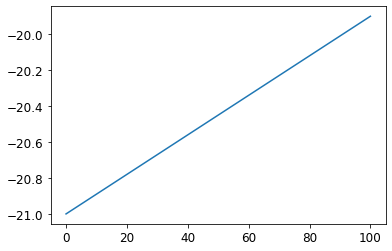

1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 26ms/step

Target model updated
1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 34ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 19ms/step

Episode: 101
Steps: 4811
Duration: 1307.4391391277313
Score: -9.0
Max Score: -9.0
Epsilon: 0.04999200000001852
1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 19ms/step

Episode: 102
Steps: 5352
Duration: 1480.85174036026
Score: -7.0
Max Score: -7.0
Epsilon: 0.04999200000001852
1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 25ms/step

Target model updated
1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 25ms/step

Weights saved!
1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 46ms/step


1/1 [==============================] - 0s 39ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 34ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 20ms/step

Episode: 103
Steps: 6426
Duration: 17159.455502033234
Score: -2.0
Max Score: -2.0
Epsilon: 0.04999200000001852
1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 35ms/step

Target model updated
1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 35ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 34ms/step


1/1 [==============================] - 0s 19ms/step

Episode: 104
Steps: 6133
Duration: 1772.776607990265
Score: -7.0
Max Score: -2.0
Epsilon: 0.04999200000001852
1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 34ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 34ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 35ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 35ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 35ms/step


1/1 [==============================] - 0s 35ms/step


1/1 [==============================] - 0s 35ms/step


1/1 [==============================] - 0s 34ms/step


1/1 [==============================] - 0s 35ms/step


1/1 [==============================] - 0s 36ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 20ms/step

Episode: 105
Steps: 7158
Duration: 15388.060083389282
Score: -7.0
Max Score: -2.0
Epsilon: 0.04999200000001852
1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 27ms/step

Target model updated
1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 31ms/step


KeyboardInterrupt: 

In [58]:
for i in range(1000):
    frames = [] # Saving the frames for the gif
    timesteps = agent.total_timesteps
    timee = time.time()
    score = play_episode(name, env, agent, debug = True) #set debug to true for rendering
    scores.append(score)
    if score > max_score:
        max_score = score

    print('\nEpisode: ' + str(i))
    print('Steps: ' + str(agent.total_timesteps - timesteps))
    print('Duration: ' + str(time.time() - timee))
    print('Score: ' + str(score))
    print('Max Score: ' + str(max_score))
    print('Epsilon: ' + str(agent.epsilon))
    
    if i%10==0 and i!=0:
        anim = plot_animation(frames)
        anim.save("pong{}.gif".format(i), dpi=100, writer= animation.PillowWriter(fps=20))# Saving the gif
        
    if i%100==0 and i!=0:
        last_100_avg.append(sum(scores)/len(scores))
        plt.plot(np.arange(0,i+1,100),last_100_avg)
        plt.show()

In [59]:
agent.model.save_weights('recent_weights.hdf5')
agent.model_target.save_weights('recent_weights_target.hdf5')
print('\nWeights saved!')


Weights saved!
